In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")

In [2]:
df=pd.read_csv("F:\DS-8(CKD)\Crop_recommendation.csv")
df

,N,P,K,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


In [4]:
df.describe()

,N,P,K,temperature,humidity,ph,rainfall
count,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000
mean,50.551818,53.362727,48.149091,25.616244,71.481779,6.469480,103.463655
std,36.917334,32.985883,50.647931,5.063749,22.263812,0.773938,54.958389
min,0.000000,5.000000,5.000000,8.825675,14.258040,3.504752,20.211267
25%,21.000000,28.000000,20.000000,22.769375,60.261953,5.971693,64.551686
50%,37.000000,51.000000,32.000000,25.598693,80.473146,6.425045,94.867624
75%,84.250000,68.000000,49.000000,28.561654,89.948771,6.923643,124.267508
max,140.000000,145.000000,205.000000,43.675493,99.981876,9.935091,298.560117


In [5]:
df.columns

Index(['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label'], dtype='object')

In [6]:
df=df.set_axis(['nitrogen', 'phosphorous', 'potassium', 'temperature', 'humidity', 'ph', 'rainfall', 'label'], axis='columns')

In [7]:
df

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


In [8]:
df.nunique()

nitrogen        137
phosphorous     117
potassium        73
temperature    2200
humidity       2200
ph             2200
rainfall       2200
label            22
dtype: int64

In [9]:
df['label'].unique()

array(['rice', 'maize', 'chickpea', 'kidneybeans', 'pigeonpeas',
       'mothbeans', 'mungbean', 'blackgram', 'lentil', 'pomegranate',
       'banana', 'mango', 'grapes', 'watermelon', 'muskmelon', 'apple',
       'orange', 'papaya', 'coconut', 'cotton', 'jute', 'coffee'],
      dtype=object)

# Data Preprocessing

In [10]:
df.drop_duplicates()

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


In [11]:
# Selecting duplicate rows except first
# occurrence based on all columns
X=df.drop('label',axis=1)
duplicate = X[X.duplicated()]

print("Duplicate Rows :")

# Print the resultant Dataframe
duplicate

Duplicate Rows :


,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall


In [12]:
df

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


In [13]:
df.groupby('label',as_index=True).mean()

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall
label,,,,,,,
apple,20.80,134.22,199.89,22.630942,92.333383,5.929663,112.654779
banana,100.23,82.01,50.05,27.376798,80.358123,5.983893,104.626980
blackgram,40.02,67.47,19.24,29.973340,65.118426,7.133952,67.884151
chickpea,40.09,67.79,79.92,18.872847,16.860439,7.336957,80.058977
coconut,21.98,16.93,30.59,27.409892,94.844272,5.976562,175.686646
coffee,101.20,28.74,29.94,25.540477,58.869846,6.790308,158.066295
cotton,117.77,46.24,19.56,23.988958,79.843474,6.912675,80.398043
grapes,23.18,132.53,200.11,23.849575,81.875228,6.025937,69.611829
jute,78.40,46.86,39.99,24.958376,79.639864,6.732778,174.792798


In [14]:
pd.pivot_table(df,index='label',values=['nitrogen', 'phosphorous', 'potassium', 'temperature', 'humidity', 'ph', 'rainfall'],aggfunc=['mean','median'])

mean                                                       \
              humidity nitrogen        ph phosphorous potassium    rainfall   
label                                                                         
apple        92.333383    20.80  5.929663      134.22    199.89  112.654779   
banana       80.358123   100.23  5.983893       82.01     50.05  104.626980   
blackgram    65.118426    40.02  7.133952       67.47     19.24   67.884151   
chickpea     16.860439    40.09  7.336957       67.79     79.92   80.058977   
coconut      94.844272    21.98  5.976562       16.93     30.59  175.686646   
coffee       58.869846   101.20  6.790308       28.74     29.94  158.066295   
cotton       79.843474   117.77  6.912675       46.24     19.56   80.398043   
grapes       81.875228    23.18  6.025937      132.53    200.11   69.611829   
jute         79.639864    78.40  6.732778       46.86     39.99  174.792798   
kidneybeans  21.605357    20.75  5.749411       67.54     20.05  105.919778   
lentil       64.804785    18.77  6.927932       68.36     19.41   45.680454   
maize        65.092249    77.76  6.245190       48.44     19.79   84.766988   
mango        50.156573    20.07  5.766373       27.18     29.92   94.704515   
mothbeans    53.160418    21.44  6.831174       48.01     20.23   51.198487   
mungbean     85.499975    20.99  6.723957       47.28     19.87   48.403601   
muskmelon    92.342802   100.32  6.358805       17.72     50.08   24.689952   
orange       92.170209    19.58  7.016957       16.55     10.01  110.474969   
papaya       92.403388    49.88  6.741442       59.05     50.04  142.627839   
pigeonpeas   48.061633    20.73  5.794175       67.73     20.29  149.457564   
pomegranate  90.125504    18.87  6.429172       18.75     40.21  107.528442   
rice         82.272822    79.89  6.425471       47.58     39.87  236.181114   
watermelon   85.160375    99.42  6.495778       17.00     50.22   50.786219   

                            median                                           \
            temperature   humidity nitrogen        ph phosphorous potassium   
label                                                                         
apple         22.630942  92.416541     24.0  5.885818       136.5     200.0   
banana        27.376798  80.223599    100.5  5.994462        81.0      50.0   
blackgram     29.973340  65.026723     41.0  7.165240        67.0      19.0   
chickpea      18.872847  16.658634     39.0  7.356537        68.0      79.0   
coconut       27.409892  94.960581     24.0  5.990709        15.5      31.0   
coffee        25.540477  57.648083    103.0  6.798626        29.0      30.0   
cotton        23.988958  80.010893    117.0  6.840957        46.0      19.0   
grapes        23.849575  81.724647     24.0  6.001785       133.0     201.0   
jute          24.958376  79.469205     78.0  6.711500        46.0      40.0   
kidneybeans   20.115085  21.348735     22.0  5.745283        67.0      20.0   
lentil        24.509052  64.094626     16.5  6.954178        68.0      19.0   
maize         22.389204  65.303845     76.0  6.259181        48.5      20.0   
mango         31.208770  50.281615     21.0  5.743385        27.5      30.0   
mothbeans     28.194920  53.668190     22.0  7.219136        48.5      20.0   
mungbean      28.525775  85.953767     22.0  6.703890        47.0      20.0   
muskmelon     28.663066  92.111116    100.0  6.353033        18.0      50.0   
orange        22.765725  91.963246     19.0  7.022614        16.0      10.0   
papaya        33.723859  92.681086     49.0  6.740830        60.0      50.0   
pigeonpeas    27.741762  47.195180     20.0  5.690466        69.5      20.0   
pomegranate   21.837842  89.911979     18.0  6.430715        20.0      40.0   
rice          23.689332  82.189357     80.0  6.363804        47.0      40.0   
watermelon    25.591767  85.030605     99.0  6.469926        17.5      50.5   

                                     
               rainfall temp

# Data Visualisation

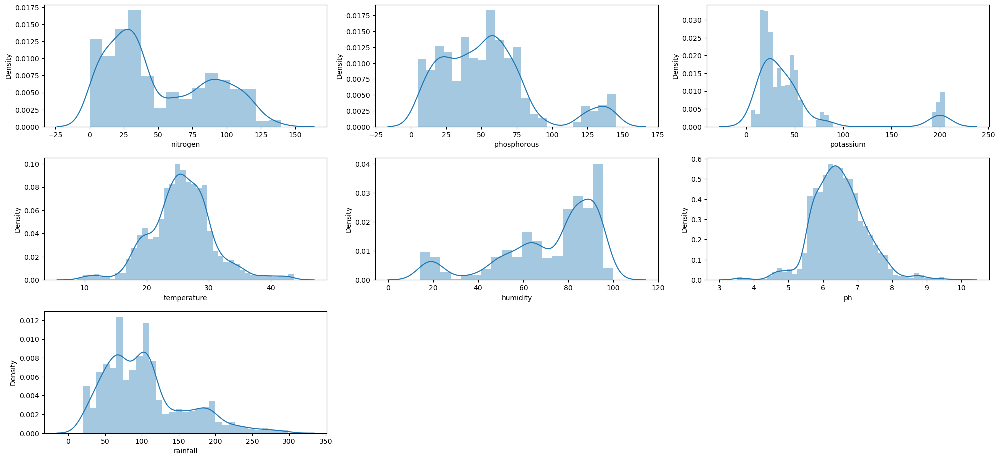

In [15]:
# checking numerical features distribution

plt.figure(figsize = (20, 15))
plotnumber = 1

for column in df.columns:
    if plotnumber <= 7:
        ax = plt.subplot(5, 3, plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column)

    plotnumber += 1

plt.tight_layout()
plt.show()

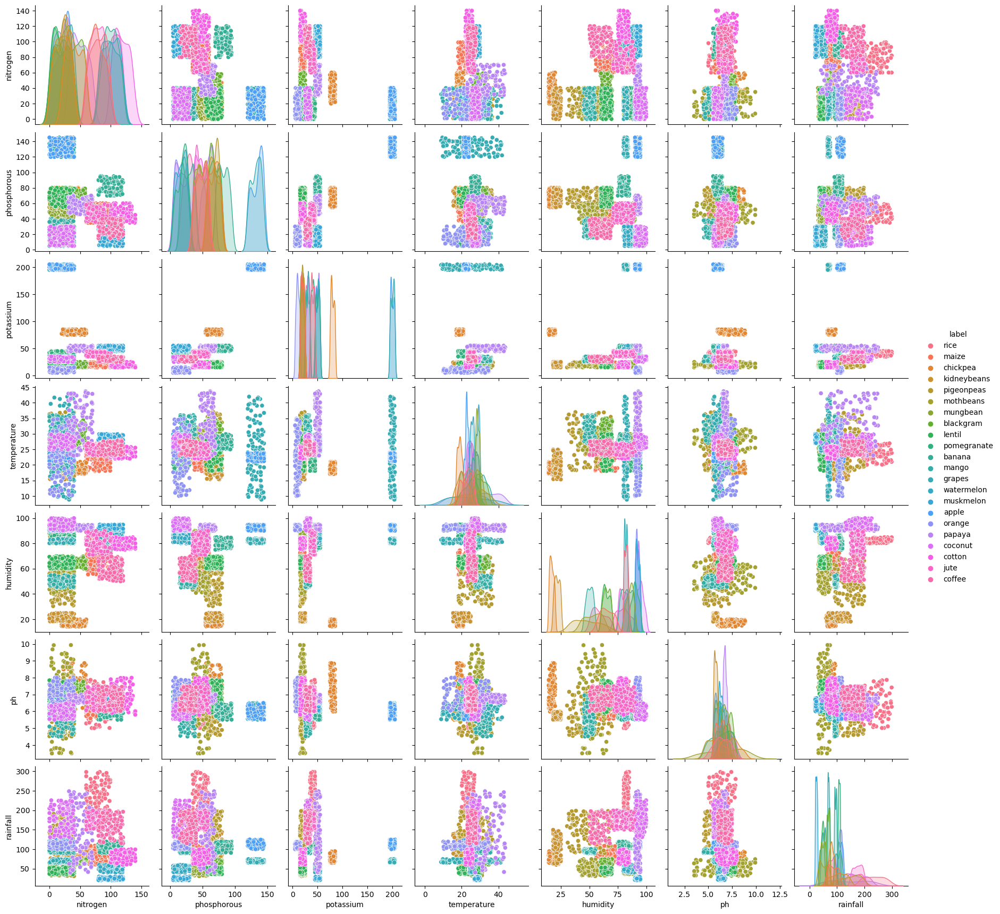

In [16]:
sns.pairplot(df,hue='label')

<Axes: xlabel='count', ylabel='label'>

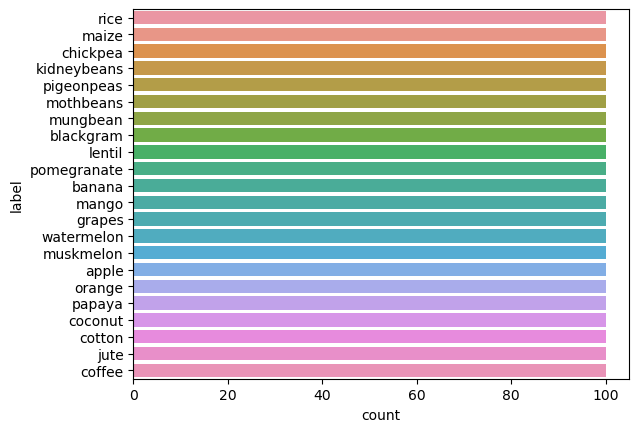

In [17]:
sns.countplot(df,y='label')

<Axes: xlabel='count', ylabel='nitrogen'>

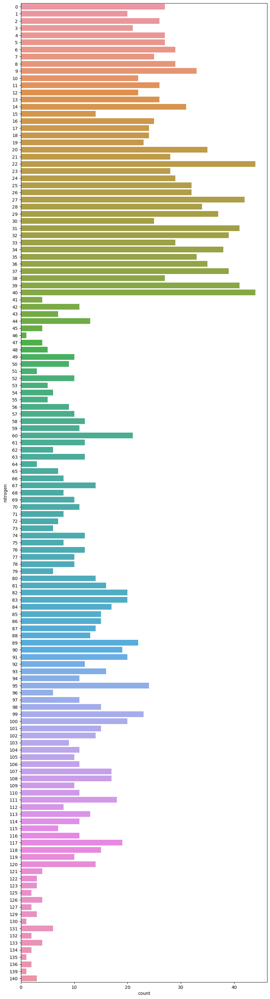

In [18]:
plt.figure(figsize=(10,40))
sns.countplot(df,y='nitrogen')

In [19]:
px.bar(df['nitrogen'],template = 'plotly_dark')

<Axes: xlabel='count', ylabel='phosphorous'>

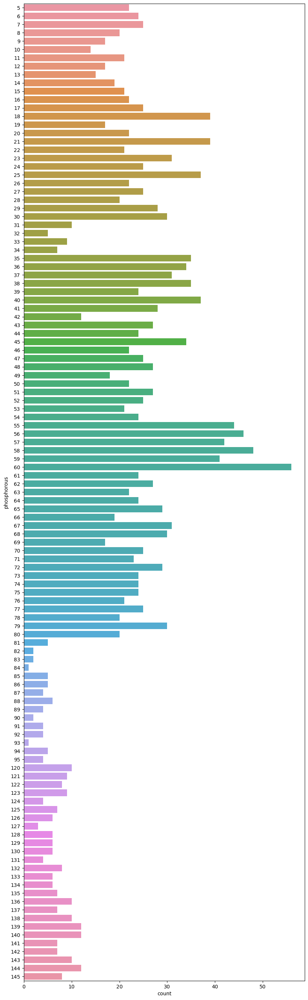

In [20]:
plt.figure(figsize=(10,35))
sns.countplot(df,y='phosphorous')

In [21]:
px.bar(df['phosphorous'],template = 'plotly_dark')

<Axes: xlabel='count', ylabel='potassium'>

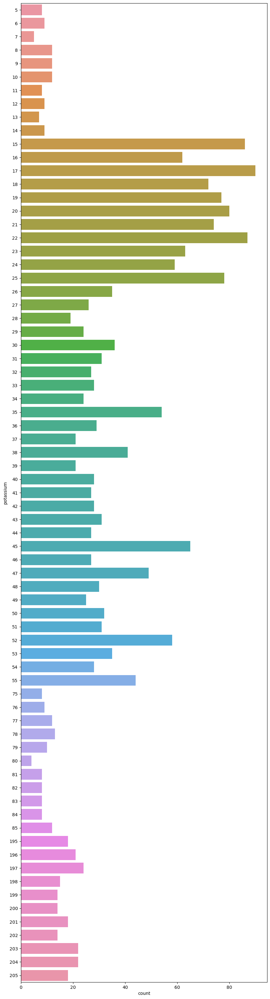

In [22]:
plt.figure(figsize=(10,40))
sns.countplot(df,y='potassium')

In [23]:
px.scatter(df,color='label',template = 'plotly_dark')

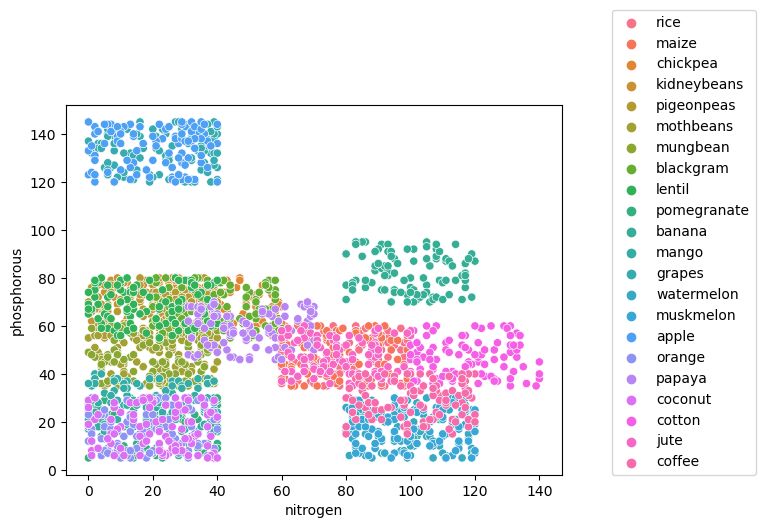

In [24]:
sns.scatterplot(df,x='nitrogen',y='phosphorous',hue='label')
plt.legend(loc=(1.1,0))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


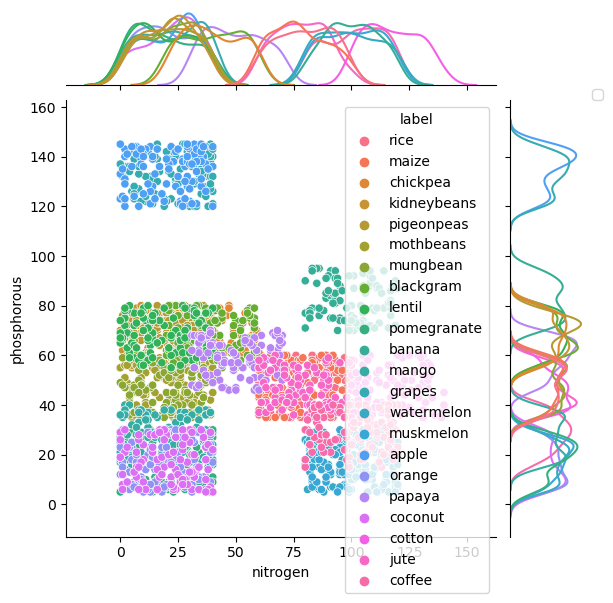

In [25]:
g = sns.JointGrid(df,x='nitrogen',y='phosphorous',hue='label')
g.plot(sns.scatterplot, sns.kdeplot)
plt.legend(loc=(1.1,1))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


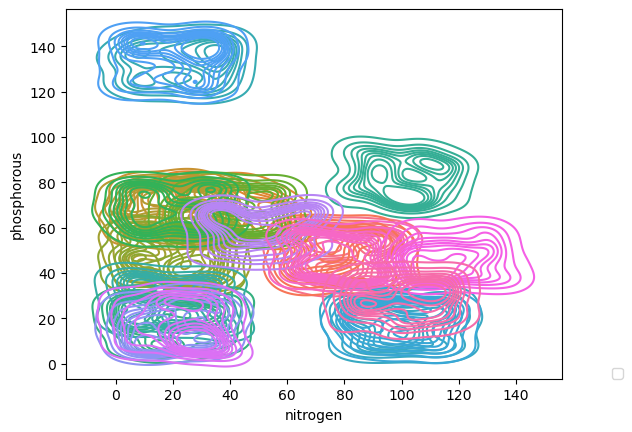

In [26]:
sns.kdeplot(df,x='nitrogen',y='phosphorous',hue='label')
plt.legend(loc=(1.1,0))

<Figure size 2000x2000 with 0 Axes>

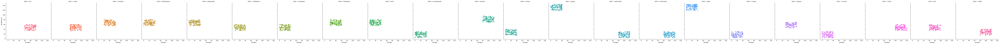

In [27]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='phosphorous',hue='label',col='label')

<Figure size 2000x2000 with 0 Axes>

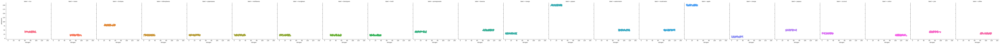

In [28]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='potassium',hue='label',col='label')

<Figure size 2000x2000 with 0 Axes>

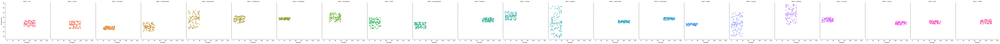

In [29]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='temperature',hue='label',col='label')

<Figure size 2000x2000 with 0 Axes>

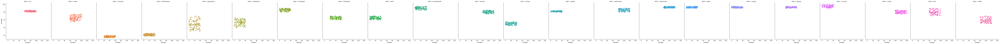

In [30]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='humidity',hue='label',col='label')

<Figure size 2000x2000 with 0 Axes>

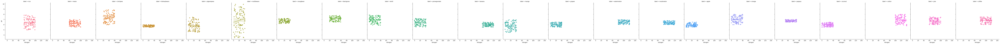

In [31]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='ph',hue='label',col='label')

<Figure size 2000x2000 with 0 Axes>

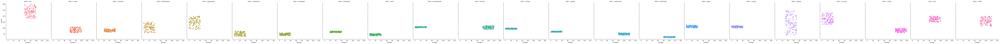

In [32]:
plt.figure(figsize=(20,20))
sns.lmplot(data=df, x='nitrogen',y='rainfall',hue='label',col='label')

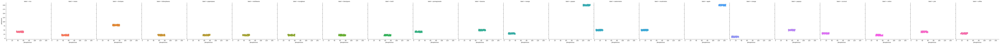

In [33]:
sns.lmplot(data=df, x='phosphorous',y='potassium',hue='label',col='label')

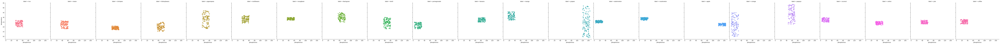

In [34]:
sns.lmplot(data=df, x='phosphorous',y='temperature',hue='label',col='label')

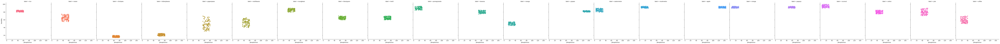

In [35]:
sns.lmplot(data=df, x='phosphorous',y='humidity',hue='label',col='label')

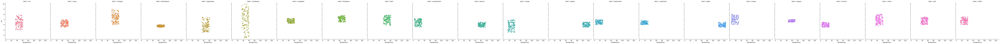

In [36]:
sns.lmplot(data=df, x='phosphorous',y='ph',hue='label',col='label')

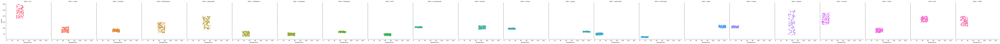

In [37]:
sns.lmplot(data=df, x='phosphorous',y='rainfall',hue='label',col='label')

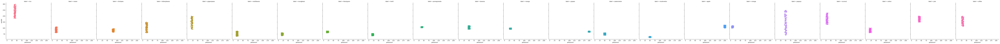

In [38]:
sns.lmplot(data=df, x='potassium',y='rainfall',hue='label',col='label')

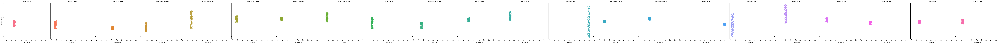

In [39]:
sns.lmplot(data=df, x='potassium',y='temperature',hue='label',col='label')

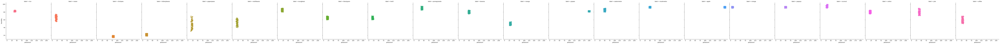

In [40]:
sns.lmplot(data=df, x='potassium',y='humidity',hue='label',col='label')

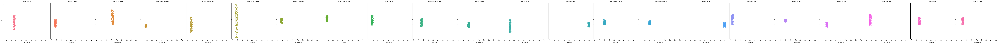

In [41]:
sns.lmplot(data=df, x='potassium',y='ph',hue='label',col='label')

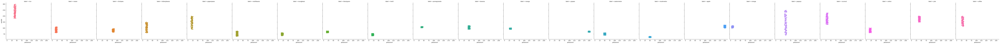

In [42]:
sns.lmplot(data=df, x='potassium',y='rainfall',hue='label',col='label')

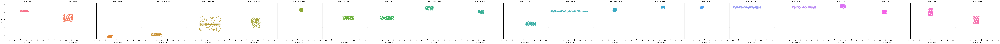

In [43]:
sns.lmplot(data=df, x='temperature',y='humidity',hue='label',col='label')

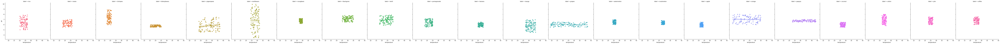

In [44]:
sns.lmplot(data=df, x='temperature',y='ph',hue='label',col='label')

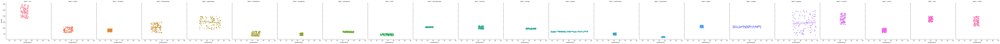

In [45]:
sns.lmplot(data=df, x='temperature',y='rainfall',hue='label',col='label')

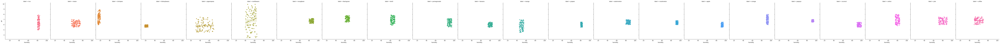

In [46]:
sns.lmplot(data=df, x='humidity',y='ph',hue='label',col='label')

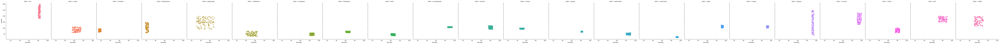

In [47]:
sns.lmplot(data=df, x='humidity',y='rainfall',hue='label',col='label')

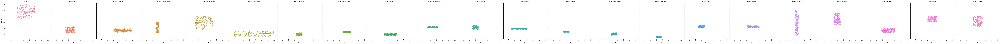

In [48]:
sns.lmplot(data=df, x='ph',y='rainfall',hue='label',col='label')

In [49]:
X1=df.copy()

<Axes: >

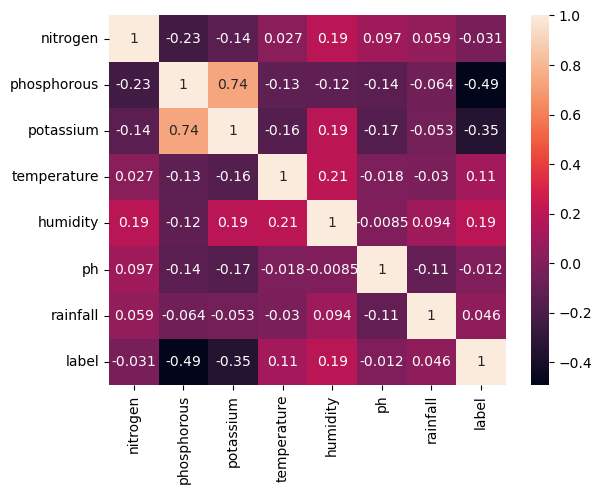

In [50]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
X1['label']=le.fit_transform(X1['label'])
sns.heatmap(X1.corr(),annot=True)

In [51]:
df

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee


In [52]:
def violin(col):
    fig = px.violin(df, y=col, x="label", color="label", box=True, template = 'plotly_dark')
    return fig.show()

for i in range(len(df.columns)-1):
  violin(df.columns[i])

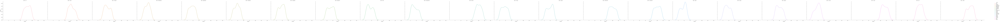

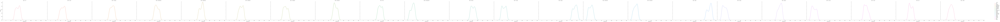

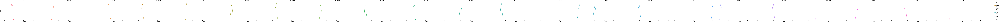

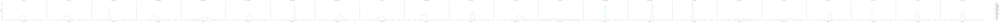

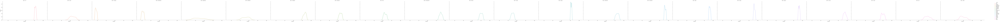

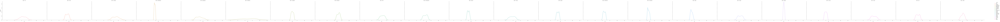

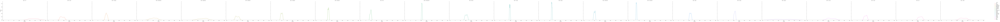

In [53]:
def kde(col):
    grid = sns.FacetGrid(df, hue="label",col="label", height = 6, aspect=2)
    grid.map(sns.kdeplot, col)
    grid.add_legend()

for i in range(len(df.columns)-1):
  kde(df.columns[i])

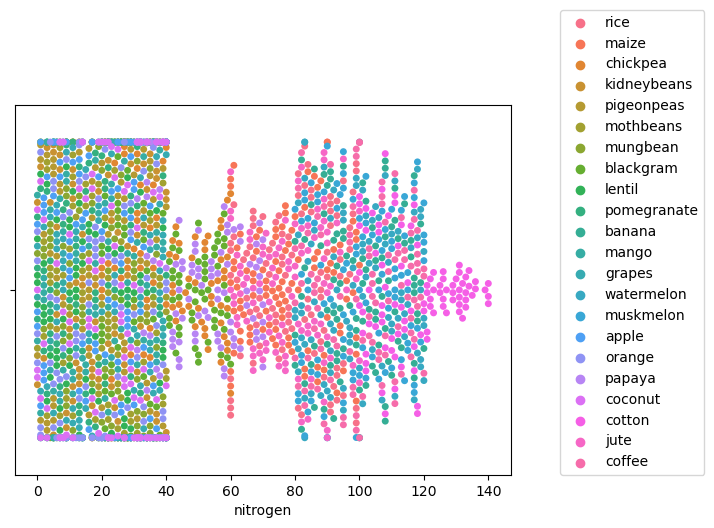

In [54]:
sns.swarmplot(df,x='nitrogen',hue='label')
plt.legend(loc=(1.1,0))

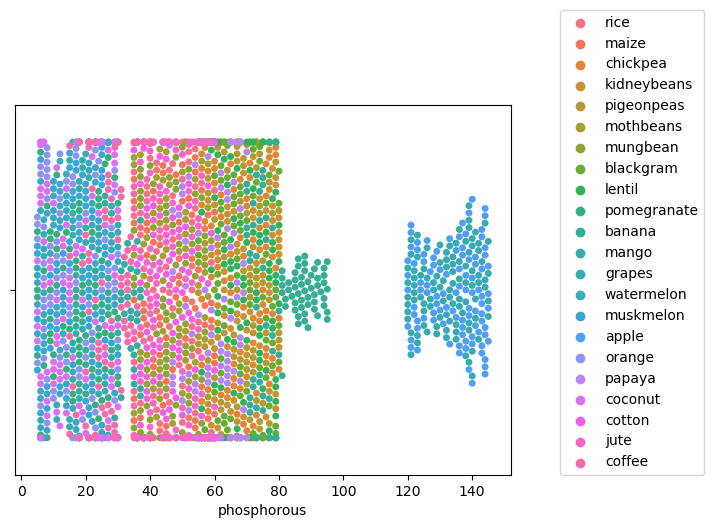

In [55]:
sns.swarmplot(df,x='phosphorous',hue='label')
plt.legend(loc=(1.1,0))

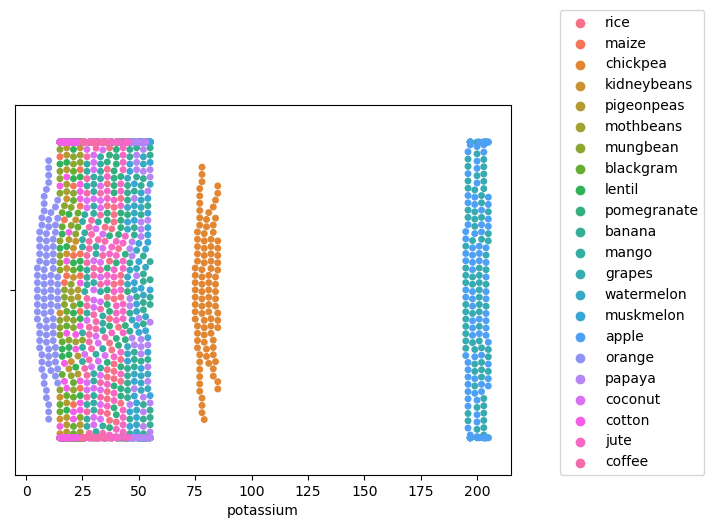

In [56]:
sns.swarmplot(df,x='potassium',hue='label')
plt.legend(loc=(1.1,0))

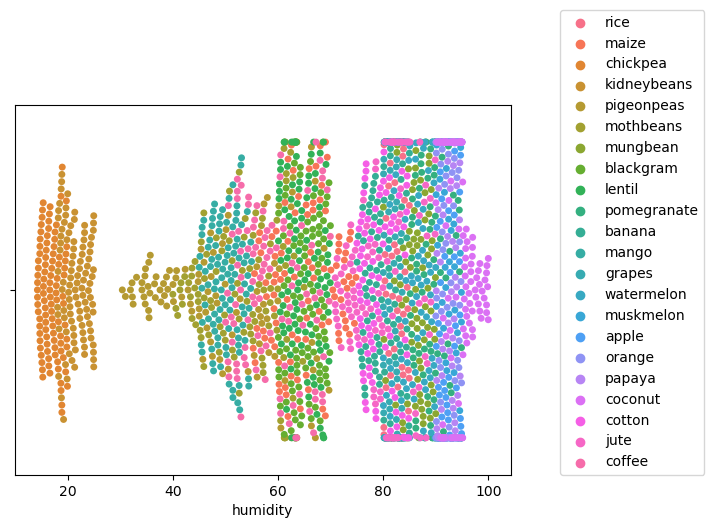

In [57]:
sns.swarmplot(df,x='humidity',hue='label')
plt.legend(loc=(1.1,0))

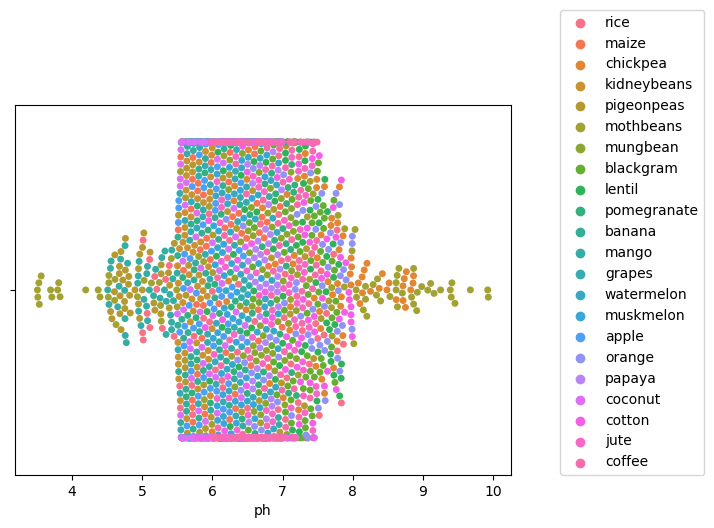

In [58]:
sns.swarmplot(df,x='ph',hue='label')
plt.legend(loc=(1.1,0))

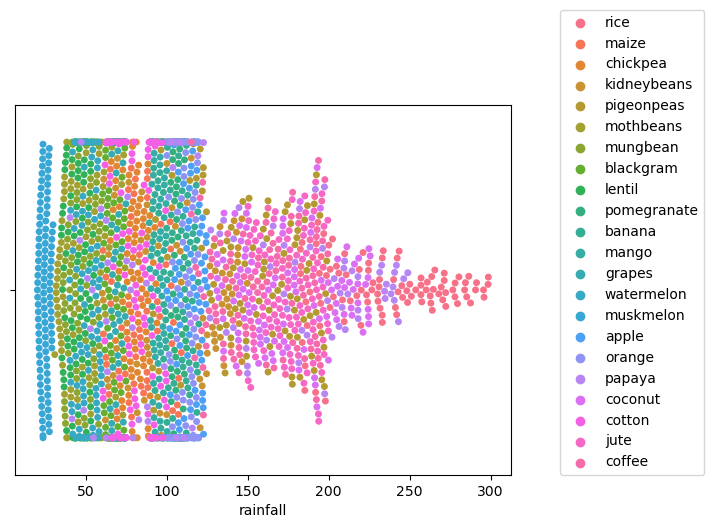

In [59]:
sns.swarmplot(df,x='rainfall',hue='label')
plt.legend(loc=(1.1,0))

In [60]:
px.strip(df,x='nitrogen',color='label',template = 'plotly_dark')

In [61]:
px.strip(df,x='phosphorous',color='label',template = 'plotly_dark')

In [62]:
px.strip(df,x='potassium',color='label',template = 'plotly_dark')

In [63]:
px.strip(df,x='humidity',color='label',template = 'plotly_dark')

In [64]:
px.strip(df,x='ph',color='label',template = 'plotly_dark')

In [65]:
px.strip(df,x='rainfall',color='label',template = 'plotly_dark')

In [66]:
df.nunique()

nitrogen        137
phosphorous     117
potassium        73
temperature    2200
humidity       2200
ph             2200
rainfall       2200
label            22
dtype: int64

# Machine Learning Model

In [67]:
X=df.drop('label',axis=1)
y=df['label']
X

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall
0,90,42,43,20.879744,82.002744,6.502985,202.935536
1,85,58,41,21.770462,80.319644,7.038096,226.655537
2,60,55,44,23.004459,82.320763,7.840207,263.964248
3,74,35,40,26.491096,80.158363,6.980401,242.864034
4,78,42,42,20.130175,81.604873,7.628473,262.717340
...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507
2196,99,15,27,27.417112,56.636362,6.086922,127.924610
2197,118,33,30,24.131797,67.225123,6.362608,173.322839
2198,117,32,34,26.272418,52.127394,6.758793,127.175293


In [68]:
y

0         rice
1         rice
2         rice
3         rice
4         rice
         ...  
2195    coffee
2196    coffee
2197    coffee
2198    coffee
2199    coffee
Name: label, Length: 2200, dtype: object

In [69]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,accuracy_score,classification_report,confusion_matrix

In [70]:
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.3, random_state=101)

In [71]:
from lazypredict.Supervised import LazyClassifier
# fitting data in LazyRegressor because
# here we are solving Regression use case.
clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)

# fitting data in LazyClassifier
models, predictions = clf.fit(X_train, X_test, y_train, y_test)
# lets check which model did better
# on  Dataset
print(models)


 90%|█████████████████████████████████████████████████████████████████████████▌        | 26/29 [00:07<00:00,  3.75it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000661 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1329
[LightGBM] [Info] Number of data points in the train set: 1540, number of used features: 7
[LightGBM] [Info] Start training from score -3.196403
[LightGBM] [Info] Start training from score -3.120030
[LightGBM] [Info] Start training from score -3.180655
[LightGBM] [Info] Start training from score -3.120030
[LightGBM] [Info] Start training from score -2.995732
[LightGBM] [Info] Start training from score -3.105431
[LightGBM] [Info] Start training from score -3.076858
[LightGBM] [Info] Start training from score -3.262000
[LightGBM] [Info] Start training from score -3.049078
[LightGBM] [Info] Start training from score -3.091042
[LightGBM] [Info] Start training from score -3.076858
[LightGBM] [Info] Start training from score -3.149883
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [00:14<00:00,  1.95it/s]

                               Accuracy  Balanced Accuracy ROC AUC  F1 Score  \
Model                                                                          
RandomForestClassifier             1.00               1.00    None      1.00   
GaussianNB                         1.00               1.00    None      1.00   
QuadraticDiscriminantAnalysis      1.00               1.00    None      1.00   
BaggingClassifier                  1.00               1.00    None      1.00   
LGBMClassifier                     1.00               1.00    None      1.00   
DecisionTreeClassifier             1.00               1.00    None      1.00   
ExtraTreesClassifier               0.99               0.99    None      0.99   
SVC                                0.99               0.99    None      0.99   
LabelPropagation                   0.98               0.98    None      0.98   
LabelSpreading                     0.98               0.98    None      0.98   
KNeighborsClassifier               0.98 

In [72]:
X=df.drop('label',axis=1)
y=df['label']
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,accuracy_score,classification_report,confusion_matrix
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.3, random_state=101)

# Decision Tree Classifier

In [90]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)

# accuracy score, confusion matrix and classification report of decision tree

dtc_acc = accuracy_score(y_test, dtc.predict(X_test))

print(f"Training Accuracy of Decision Tree Classifier is {accuracy_score(y_train, dtc.predict(X_train))}")
print(f"Test Accuracy of Decision Tree Classifier is {dtc_acc} \n")

print(f"Confusion Matrix :- \n{confusion_matrix(y_test, dtc.predict(X_test))}\n")
print(f"Classification Report :- \n {classification_report(y_test, dtc.predict(X_test))}")

Training Accuracy of Decision Tree Classifier is 1.0
Test Accuracy of Decision Tree Classifier is 0.9954545454545455 

Confusion Matrix :- 
[[37  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 23  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 31  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 41  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 27  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0 30  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0 34  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0 

# Adaboost Classifier

In [74]:
from sklearn.ensemble import AdaBoostClassifier

ada = AdaBoostClassifier(base_estimator = dtc)
ada.fit(X_train, y_train)

# accuracy score, confusion matrix and classification report of ada boost

ada_acc = accuracy_score(y_test, ada.predict(X_test))

print(f"Training Accuracy of Ada Boost Classifier is {accuracy_score(y_train, ada.predict(X_train))}")
print(f"Test Accuracy of Ada Boost Classifier is {ada_acc} \n")

print(f"Confusion Matrix :- \n{confusion_matrix(y_test, ada.predict(X_test))}\n")
print(f"Classification Report :- \n {classification_report(y_test, ada.predict(X_test))}")


Training Accuracy of Ada Boost Classifier is 1.0
Test Accuracy of Ada Boost Classifier is 0.9954545454545455 

Confusion Matrix :- 
[[37  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 23  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 31  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 41  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 26  0  0  0  0  0  0  0  0  0  0  0  1  0]
 [ 0  0  0  0  0  0  0  0  0 30  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0 34  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 33

# Gradient Boosting Classifier

In [75]:
from sklearn.ensemble import GradientBoostingClassifier

gb = GradientBoostingClassifier()
gb.fit(X_train, y_train)

# accuracy score, confusion matrix and classification report of gradient boosting classifier

gb_acc = accuracy_score(y_test, gb.predict(X_test))

print(f"Training Accuracy of Gradient Boosting Classifier is {accuracy_score(y_train, gb.predict(X_train))}")
print(f"Test Accuracy of Gradient Boosting Classifier is {gb_acc} \n")

print(f"Confusion Matrix :- \n{confusion_matrix(y_test, gb.predict(X_test))}\n")
print(f"Classification Report :- \n {classification_report(y_test, gb.predict(X_test))}")

Training Accuracy of Gradient Boosting Classifier is 1.0
Test Accuracy of Gradient Boosting Classifier is 0.9939393939393939 

Confusion Matrix :- 
[[37  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 31  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 23  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 31  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 41  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 27  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0 30  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  1  0 28  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0 34  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  

# LGBM

In [76]:
from lightgbm import LGBMClassifier

lgbm = LGBMClassifier(learning_rate = 1)
lgbm.fit(X_train, y_train)

# accuracy score, confusion matrix and classification report of lgbm classifier

lgbm_acc = accuracy_score(y_test, lgbm.predict(X_test))

print(f"Training Accuracy of LGBM Classifier is {accuracy_score(y_train, lgbm.predict(X_train))}")
print(f"Test Accuracy of LGBM Classifier is {lgbm_acc} \n")

print(f"{confusion_matrix(y_test, lgbm.predict(X_test))}\n")
print(classification_report(y_test, lgbm.predict(X_test)))

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000964 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1328
[LightGBM] [Info] Number of data points in the train set: 1540, number of used features: 7
[LightGBM] [Info] Start training from score -3.196403
[LightGBM] [Info] Start training from score -3.120030
[LightGBM] [Info] Start training from score -3.180655
[LightGBM] [Info] Start training from score -3.120030
[LightGBM] [Info] Start training from score -2.995732
[LightGBM] [Info] Start training from score -3.105431
[LightGBM] [Info] Start training from score -3.076858
[LightGBM] [Info] Start training from score -3.262000
[LightGBM] [Info] Start training from score -3.049078
[LightGBM] [Info] Start training from score -3.091042
[LightGBM] [Info] Start training from score -3.076858
[LightGBM] [Info] Start training from score -3.149883
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

# Guassian Naive Bayes

In [77]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

# Initialize the Gaussian Naive Bayes classifier
gnb = GaussianNB()
gnb.fit(X_train, y_train)
gnb_acc = accuracy_score(y_test, gnb.predict(X_test))
print(f"Training Accuracy of LGBM Classifier is {accuracy_score(y_train, gnb.predict(X_train))}")
print(f"Test Accuracy of LGBM Classifier is {gnb_acc} \n")

print(f"{confusion_matrix(y_test, gnb.predict(X_test))}\n")
print(classification_report(y_test, gnb.predict(X_test)))


Training Accuracy of LGBM Classifier is 0.9948051948051948
Test Accuracy of LGBM Classifier is 0.9954545454545455 

[[37  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 32  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 23  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 31  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 41  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 27  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0 30  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0 29  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  1  0  0  0  0 33  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 33  0  0  0  0  0 

In [79]:
models = pd.DataFrame({
    'Model' : [ 'Decision Tree Classifier','Ada Boost Classifier','Gradient Boosting Classifier', 'Light GBM','Naive Bayes'],
    'Score' : [ dtc_acc, ada_acc, gb_acc, lgbm_acc,gnb_acc]
})
models

,Model,Score
0,Decision Tree Classifier,1.00
1,Ada Boost Classifier,1.00
2,Gradient Boosting Classifier,0.99
3,Light GBM,0.27
4,Naive Bayes,1.00


In [81]:
px.bar(data_frame = models, x = 'Score', y = 'Model', color = 'Score', template = 'plotly_dark',
       title = 'Models Comparison')

In [82]:
X1=df.copy()
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
X1['label']=le.fit_transform(X1['label'])

In [83]:
import numpy as np
index_val=np.random.randint(2199, size=1)
print(index_val)

[1118]


In [84]:
class_droped_df = X1.drop('label', axis=1)
features= class_droped_df.loc[index_val].to_numpy()
print(features)

[[14.         18.         30.         29.80747243 52.13797867  5.19126512
  95.74606104]]


In [85]:
features_original_val= X1.loc[index_val].to_numpy()
print(features_original_val)

[[14.         18.         30.         29.80747243 52.13797867  5.19126512
  95.74606104 12.        ]]


In [86]:
X1

,nitrogen,phosphorous,potassium,temperature,humidity,ph,rainfall,label
0,90,42,43,20.88,82.00,6.50,202.94,20
1,85,58,41,21.77,80.32,7.04,226.66,20
2,60,55,44,23.00,82.32,7.84,263.96,20
3,74,35,40,26.49,80.16,6.98,242.86,20
4,78,42,42,20.13,81.60,7.63,262.72,20
...,...,...,...,...,...,...,...,...
2195,107,34,32,26.77,66.41,6.78,177.77,5
2196,99,15,27,27.42,56.64,6.09,127.92,5
2197,118,33,30,24.13,67.23,6.36,173.32,5
2198,117,32,34,26.27,52.13,6.76,127.18,5


In [87]:
prediction = dtc.predict(features)
print("Prediction: {}".format(prediction))

Prediction: ['mango']
